# Python Plotly Module 

### Importing Generall Modules

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

### Importing Plotly & Cufflinks Modules

In [2]:
from plotly.offline import iplot
import plotly as py
import plotly.tools as tls
import cufflinks as cf

### Cheking the Plotly Version

In [3]:
print(py.__version__)

4.7.0


### Seeing The Plotly Parameters

In [4]:
df = pd.DataFrame()
df.iplot

<bound method _iplot of Empty DataFrame
Columns: []
Index: []>

### Checking The Type Of the Object

In [5]:
type(df.iplot)

method

In [6]:
help(df.iplot)

Help on method _iplot in module cufflinks.plotlytools:

_iplot(kind='scatter', data=None, layout=None, filename='', sharing=None, title='', xTitle='', yTitle='', zTitle='', theme=None, colors=None, colorscale=None, fill=False, width=None, dash='solid', mode='', interpolation='linear', symbol='circle', size=12, barmode='', sortbars=False, bargap=None, bargroupgap=None, bins=None, histnorm='', histfunc='count', orientation='v', boxpoints=False, annotations=None, keys=False, bestfit=False, bestfit_colors=None, mean=False, mean_colors=None, categories='', x='', y='', z='', text='', gridcolor=None, zerolinecolor=None, margin=None, labels=None, values=None, secondary_y='', secondary_y_title='', subplots=False, shape=None, error_x=None, error_y=None, error_type='data', locations=None, lon=None, lat=None, asFrame=False, asDates=False, asFigure=False, asImage=False, dimensions=None, asPlot=False, asUrl=False, online=None, **kwargs) method of pandas.core.frame.DataFrame instance
           Retur

### Making The Plotly And Cufflinks As Offline Mode Working

In [7]:
py.offline.init_notebook_mode(connected = True)
cf.go_offline()


### Creating A Data Set

In [8]:
df = pd.DataFrame(data = np.random.randn(100, 3), columns = list("ABC")) #np.random.randn(n_rows, n_cols)
df.head()

,A,B,C
0,1.954180,0.292274,0.251980
1,-3.338529,-0.076192,0.639122
2,0.380250,0.581723,-1.312702
3,-0.471326,1.972673,-1.386304
4,-0.844628,-0.459363,0.201081


### Matplotlib Plotting

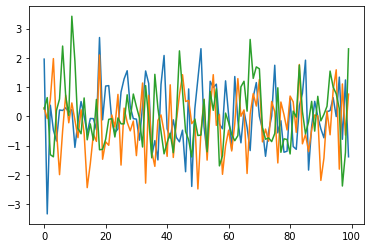

In [9]:
plt.plot(df)


### Plotly Plotting

In [10]:
df.iplot()

### Customizes The Graph A little Bit

In [11]:
df['A'] = df['A'].cumsum()
df['B'] = df['B'].cumsum()
df['C'] = df['C'].cumsum()
df.head(10)


,A,B,C
0,1.954180,0.292274,0.251980
1,-1.384349,0.216083,0.891102
2,-1.004100,0.797806,-0.421600
3,-1.475425,2.770479,-1.807904
4,-2.320053,2.311117,-1.606823
5,-2.105269,0.315638,-1.014014
6,-1.906934,-0.184504,1.387487
7,-1.616957,0.538362,2.086523
8,-1.477619,0.316159,2.112178
9,-1.249544,0.772423,5.533027


In [12]:
df.iplot()

In [13]:
df.iplot(x = 'A', y = 'B')

In [31]:
df.iplot(x = 'A', y = 'B', mode = 'markers')

# Plotly Basic Plots

# Scatter Plots

### Scatter plot with Plotly Express

    '''
        Plotly Express is the easy-to-use, high-level interface to Plotly, which operates on 
        "tidy" data and produces easy-to-style figures.

        With px.scatter, each data point is represented as a marker point, whose location 
        is given by the x and y columns.
    
    '''

In [14]:
import plotly.express as px

fig = px.scatter(x = [0, 1, 2, 3, 4], y = [0, 2, 4, 9, 16], title = "Scatter Ploting With Plotly Express" )
fig.show()


### From Iris DataFrame Data Set

In [55]:
df1 = sns.load_dataset(name = 'iris')
df1.head()
fig = px.scatter(data_frame = df1, x = 'sepal_width', y = 'sepal_length')
fig.show()

### Another Way To Draw The Scatter Plot

In [56]:
# x and y given as DataFrame columns
df1 = px.data.iris() # iris is a pandas DataFrame 
fig = px.scatter(df, x="sepal_width", y="sepal_length")
fig.show()

### Setting size and color with column names

In [58]:
import plotly.express as px
df1 = px.data.iris()
fig = px.scatter(df1, x="sepal_width", y="sepal_length", color="species", size='petal_length', hover_data=['petal_width'])
fig.show()

### Scatter and line plot with go.Scatter

    '''
        If Plotly Express does not provide a good starting point, it is possible to use the 
        more generic go.Scatter function from plotly.graph_objects. 
        
        Whereas plotly.express has two functions scatter and line, go.Scatter can be used 
        both for plotting points (makers) or lines, depending on the value of mode. 

    '''

In [68]:
import plotly.graph_objects as go

t = np.linspace(0, 10, 100)
y = np.cos(t)

fig = go.Figure(data=go.Scatter(x=t, y=y, mode='markers'))

fig.show()

### Bubble Scatter Plots

In [69]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Scatter(
    x=[1, 2, 3, 4],
    y=[10, 11, 12, 13],
    mode='markers',
    marker=dict(size=[40, 60, 80, 100],
                color=[0, 1, 2, 3])
))

fig.show()

### Style Scatter Plots

In [70]:
t = np.linspace(0, 10, 100)

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=t, y=np.sin(t),
    name='sin',
    mode='markers',
    marker_color='rgba(152, 0, 0, .8)'
))

fig.add_trace(go.Scatter(
    x=t, y=np.cos(t),
    name='cos',
    marker_color='rgba(255, 182, 193, .9)'
))

# Set options common to all traces with fig.update_traces
fig.update_traces(mode='markers', marker_line_width=2, marker_size=10)
fig.update_layout(title='Styled Scatter',
                  yaxis_zeroline=False, xaxis_zeroline=False)


fig.show()

### Data Labels on Hover

In [73]:
import plotly.graph_objects as go
import pandas as pd

data= pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/2014_usa_states.csv")

fig = go.Figure(data=go.Scatter(x=data['Postal'],
                                y=data['Population'],
                                mode='markers',
                                marker_color=data['Population'],
                                text=data['State'])
               ) # hover text goes here

fig.update_layout(title='Population of USA States')
fig.show()

### Scatter with a Color Dimension

In [74]:
fig = go.Figure(data=go.Scatter(
    y = np.random.randn(500),
    mode='markers',
    marker=dict(
        size=16,
        color=np.random.randn(500), #set color equal to a variable
        colorscale='Viridis', # one of plotly colorscales
        showscale=True
    )
))

fig.show()

### Large Data Sets

    '''
        Now in Ploty you can implement WebGL with Scattergl() in place of Scatter() 
        
        for increased speed, improved interactivity, and the ability to plot even more data!
    
    '''

In [75]:
N = 100000
fig = go.Figure(data=go.Scattergl(
    x = np.random.randn(N),
    y = np.random.randn(N),
    mode='markers',
    marker=dict(
        color=np.random.randn(N),
        colorscale='Viridis',
        line_width=1
    )
))

fig.show()

### With Uniformly Distributed Data

In [76]:
import plotly.graph_objects as go
import numpy as np

N = 100000
r = np.random.uniform(0, 1, N)
theta = np.random.uniform(0, 2*np.pi, N)

fig = go.Figure(data=go.Scattergl(
    x = r * np.cos(theta), # non-uniform distribution
    y = r * np.sin(theta), # zoom to see more points at the center
    mode='markers',
    marker=dict(
        color=np.random.randn(N),
        colorscale='Viridis',
        line_width=1
    )
))

fig.show()

# Line Charts

    '''
        With px.line, each data point is represented as a vertex (which location is given 
        by the x and y columns) of a polyline mark in 2D space.
    
    '''

### Simple Line Plot with plotly.express

In [77]:
df3 = px.data.gapminder().query("country=='Canada'")
fig = px.line(df3, x="year", y="lifeExp", title='Life expectancy in Canada')
fig.show()

### Line plot with Plotly Express Creating Cosine Wave

In [59]:
t = np.linspace(0, 2*np.pi, 100)

fig = px.line(x=t, y=np.cos(t), labels={'x':'t', 'y':'cos(t)'})
fig.show()

### Working With Gapminder Data Set

In [83]:
df3 = px.data.gapminder()
df3.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
0,Afghanistan,Asia,1952,28.801,8425333,779.445314,AFG,4
1,Afghanistan,Asia,1957,30.332,9240934,820.853030,AFG,4
2,Afghanistan,Asia,1962,31.997,10267083,853.100710,AFG,4
3,Afghanistan,Asia,1967,34.020,11537966,836.197138,AFG,4
4,Afghanistan,Asia,1972,36.088,13079460,739.981106,AFG,4


### Line Plot with column encoding color

In [78]:
df3 = px.data.gapminder().query("continent=='Oceania'")
fig = px.line(df3, x="year", y="lifeExp", color='country')
fig.show()

In [79]:
df3 = px.data.gapminder().query("continent != 'Asia'") # remove Asia for visibility
fig = px.line(df3, x="year", y="lifeExp", color="continent",
              line_group="country", hover_name="country")
fig.show()

### Line Plot with go.Scatter

In [84]:
import plotly.graph_objects as go
import numpy as np

x = np.arange(10)

fig = go.Figure(data=go.Scatter(x=x, y=x**2))
fig.show()

### Line Plot Modes

In [85]:
# Create random data with numpy
import numpy as np
np.random.seed(1)

N = 100
random_x = np.linspace(0, 1, N)
random_y0 = np.random.randn(N) + 5
random_y1 = np.random.randn(N)
random_y2 = np.random.randn(N) - 5

# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=random_x, y=random_y0,
                    mode='lines',
                    name='lines'))
fig.add_trace(go.Scatter(x=random_x, y=random_y1,
                    mode='lines+markers',
                    name='lines+markers'))
fig.add_trace(go.Scatter(x=random_x, y=random_y2,
                    mode='markers', name='markers'))

fig.show()

### Style Line Plots

In [86]:

# Add data
month = ['January', 'February', 'March', 'April', 'May', 'June', 'July',
         'August', 'September', 'October', 'November', 'December']
high_2000 = [32.5, 37.6, 49.9, 53.0, 69.1, 75.4, 76.5, 76.6, 70.7, 60.6, 45.1, 29.3]
low_2000 = [13.8, 22.3, 32.5, 37.2, 49.9, 56.1, 57.7, 58.3, 51.2, 42.8, 31.6, 15.9]
high_2007 = [36.5, 26.6, 43.6, 52.3, 71.5, 81.4, 80.5, 82.2, 76.0, 67.3, 46.1, 35.0]
low_2007 = [23.6, 14.0, 27.0, 36.8, 47.6, 57.7, 58.9, 61.2, 53.3, 48.5, 31.0, 23.6]
high_2014 = [28.8, 28.5, 37.0, 56.8, 69.7, 79.7, 78.5, 77.8, 74.1, 62.6, 45.3, 39.9]
low_2014 = [12.7, 14.3, 18.6, 35.5, 49.9, 58.0, 60.0, 58.6, 51.7, 45.2, 32.2, 29.1]

fig = go.Figure()
# Create and style traces
fig.add_trace(go.Scatter(x=month, y=high_2014, name='High 2014',
                         line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=month, y=low_2014, name = 'Low 2014',
                         line=dict(color='royalblue', width=4)))
fig.add_trace(go.Scatter(x=month, y=high_2007, name='High 2007',
                         line=dict(color='firebrick', width=4,
                              dash='dash') # dash options include 'dash', 'dot', and 'dashdot'
))
fig.add_trace(go.Scatter(x=month, y=low_2007, name='Low 2007',
                         line = dict(color='royalblue', width=4, dash='dash')))
fig.add_trace(go.Scatter(x=month, y=high_2000, name='High 2000',
                         line = dict(color='firebrick', width=4, dash='dot')))
fig.add_trace(go.Scatter(x=month, y=low_2000, name='Low 2000',
                         line=dict(color='royalblue', width=4, dash='dot')))

# Edit the layout
fig.update_layout(title='Average High and Low Temperatures in New York',
                   xaxis_title='Month',
                   yaxis_title='Temperature (degrees F)')


fig.show()

### Connect Data Gaps

    '''
        connectgaps determines if missing values in the provided data are shown as a gap in the graph or not. 
        
        In this tutorial, we showed how to take benefit of this feature and illustrate multiple 
        areas in mapbox.
    
    '''

In [88]:
x = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x,
    y=[10, 20, None, 15, 10, 5, 15, None, 20, 10, 10, 15, 25, 20, 10],
    name = '<b>No</b> Gaps', # Style name/legend entry with html tags
    connectgaps=True # override default to connect the gaps
))
fig.add_trace(go.Scatter(
    x=x,
    y=[5, 15, None, 10, 5, 0, 10, None, 15, 5, 5, 10, 20, 15, 5],
    name='Gaps',
))

fig.show()

### Interpolation with Line Plots

In [89]:
x = np.array([1, 2, 3, 4, 5])
y = np.array([1, 3, 2, 3, 1])

fig = go.Figure()
fig.add_trace(go.Scatter(x=x, y=y, name="linear",
                    line_shape='linear'))
fig.add_trace(go.Scatter(x=x, y=y + 5, name="spline",
                    text=["tweak line smoothness<br>with 'smoothing' in line object"],
                    hoverinfo='text+name',
                    line_shape='spline'))
fig.add_trace(go.Scatter(x=x, y=y + 10, name="vhv",
                    line_shape='vhv'))
fig.add_trace(go.Scatter(x=x, y=y + 15, name="hvh",
                    line_shape='hvh'))
fig.add_trace(go.Scatter(x=x, y=y + 20, name="vh",
                    line_shape='vh'))
fig.add_trace(go.Scatter(x=x, y=y + 25, name="hv",
                    line_shape='hv'))

fig.update_traces(hoverinfo='text+name', mode='lines+markers')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()


### Bar Charts

### Bar chart with Plotly Express

    '''
        With px.bar, each row of the DataFrame is represented as a rectangular mark.
    
    '''

In [90]:
data_canada = px.data.gapminder().query("country == 'Canada'")
fig = px.bar(data_canada, x='year', y='pop')
fig.show()

### Customize bar chart with Plotly Express

In [95]:
data = px.data.gapminder()

data_canada = data[data.country == 'Canada']
fig = px.bar(data_canada, x='year', y='pop',
             hover_data=['lifeExp', 'gdpPercap'], color='lifeExp',
             labels={'pop':'population of Canada'}, height=400)
fig.show()

### Normal Bar Charts With Dictionary Type Objects

In [178]:
trace = go.Bar(x = ['Jan', 'Feb', "Mar"], y = [30.56, 22.7, 45.60])
trace

Bar({
    'x': ['Jan', 'Feb', 'Mar'], 'y': [30.56, 22.7, 45.6]
})

In [183]:
trace = go.Bar(x = ['Jan', 'Feb', "Mar"], y = [30.56, 22.7, 45.60])
data = [trace]
fig = go.Figure(data = data)
fig.show()


### Adding Title 

In [184]:
layout = {'title':"Sales for First Quarter"}
fig = go.Figure(data = data, layout = layout)
fig.show()

### Adding Axes Labels

In [188]:
layout = {
          'title': "First Quarter Sales",
         'xaxis': {'title': 'Months'},
         'yaxis':{'title': 'Units'}
         }
fig = go.Figure(data = data, layout = layout)
fig.show()

In [197]:
layout = {
          'title': "First Quarter Sales",
         'xaxis': {'title': 'Months'},
         'yaxis':{'title': 'Units'}
         }
iplot(figure_or_data = {'data': data, 'layout':layout}, image_width = 100, image_height = 400)

### Adding the Markers(Colors) And the Hover Text

In [213]:
trace = go.Bar(x = ['Jan', 'Feb', "Mar"], 
               y = [30.56, 22.7, 45.60],
              marker =dict(color = ['rgba(255, 0, 0, 1)', 'rgba(0, 255, 245 , 1)', 'rgba(255, 135, 100, 0.5)']),
              text = ["Below Target", "Above Target", "Max of Target"]
             )
               
               
data = [trace]
               
layout = {'title':"First Quarter Sales ",
         'xaxis':{'title': "Months", 'tickangle': -25},
         'yaxis': {'title': "Units"}
         }
fig = go.Figure({'data': data,  'layout' : layout })
fig.show()

### Specifying The Bar Mode 

In [97]:
df4 = px.data.tips()

fig = px.bar(df4, x="sex", y="total_bill", color='smoker', barmode='group',
             height=400)
fig.show()

### Facetted subplots

    '''
        Use the keyword arguments facet_row (resp. facet_col) to create facetted subplots, where different rows
        (resp. columns) correspond to different values of the dataframe column specified in facet_row.
    
    '''

In [99]:
fig = px.bar(df4, x="sex", y="total_bill", color="smoker", barmode="group",
             facet_row="time", facet_col="day",
             category_orders={"day": ["Thur", "Fri", "Sat", "Sun"],
                              "time": ["Lunch", "Dinner"]})
fig.show()

### Grouped Bar Chart

In [100]:
animals=['giraffes', 'orangutans', 'monkeys']

fig = go.Figure(data=[
    go.Bar(name='SF Zoo', x=animals, y=[20, 14, 23]),
    go.Bar(name='LA Zoo', x=animals, y=[12, 18, 29])
])
# Change the bar mode
fig.update_layout(barmode='group')
fig.show()

### Stacked Bar Chart

In [101]:
animals=['giraffes', 'orangutans', 'monkeys']

fig = go.Figure(data=[
    go.Bar(name='SF Zoo', x=animals, y=[20, 14, 23]),
    go.Bar(name='LA Zoo', x=animals, y=[12, 18, 29])
])
# Change the bar mode
fig.update_layout(barmode='stack')
fig.show()

### Bar Chart with Hover Text

In [102]:

x = ['Product A', 'Product B', 'Product C']
y = [20, 14, 23]

# Use the hovertext kw argument for hover text
fig = go.Figure(data=[go.Bar(x=x, y=y,
            hovertext=['27% market share', '24% market share', '19% market share'])])
# Customize aspect
fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.6)
fig.update_layout(title_text='January 2013 Sales Report')
fig.show()

### Bar Chart with Direct Labels

In [103]:
x = ['Product A', 'Product B', 'Product C']
y = [20, 14, 23]

# Use textposition='auto' for direct text
fig = go.Figure(data=[go.Bar(
            x=x, y=y,
            text=y,
            textposition='auto',
        )])

fig.show()

### Controlling text fontsize with uniformtext

    '''
        If you want all the text labels to have the same size, you can use the uniformtext layout parameter.
        The minsize attribute sets the font size, and the mode attribute sets what happens for labels 
        which cannot fit with the desired fontsize: either hide them or show them with overflow.
        In the example below we also force the text to be outside of bars with textposition.
    
    '''


In [104]:
df5 = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop > 2.e6")
fig = px.bar(df5, y='pop', x='country', text='pop')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

### Rotated Bar Chart Labels

In [105]:
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
          'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

fig = go.Figure()
fig.add_trace(go.Bar(
    x=months,
    y=[20, 14, 25, 16, 18, 22, 19, 15, 12, 16, 14, 17],
    name='Primary Product',
    marker_color='indianred'
))
fig.add_trace(go.Bar(
    x=months,
    y=[19, 14, 22, 14, 16, 19, 15, 14, 10, 12, 12, 16],
    name='Secondary Product',
    marker_color='lightsalmon'
))

# Here we modify the tickangle of the xaxis, resulting in rotated labels.
fig.update_layout(barmode='group', xaxis_tickangle=-45)
fig.show()

### Customizing Individual Bar Colors

In [106]:
colors = ['lightslategray',] * 5
colors[1] = 'crimson'

fig = go.Figure(data=[go.Bar(
    x=['Feature A', 'Feature B', 'Feature C',
       'Feature D', 'Feature E'],
    y=[20, 14, 23, 25, 22],
    marker_color=colors # marker color can be a single color value or an iterable
)])
fig.update_layout(title_text='Least Used Feature')

### Customizing Individual Bar Widths

In [107]:
fig = go.Figure(data=[go.Bar(
    x=[1, 2, 3, 5.5, 10],
    y=[10, 8, 6, 4, 2],
    width=[0.8, 0.8, 0.8, 3.5, 4] # customize width here
)])

fig.show()

### Customizing Individual Bar Base

In [108]:
years = ['2016','2017','2018']

fig = go.Figure()
fig.add_trace(go.Bar(x=years, y=[500, 600, 700],
                base=[-500,-600,-700],
                marker_color='crimson',
                name='expenses'))
fig.add_trace(go.Bar(x=years, y=[300, 400, 700],
                base=0,
                marker_color='lightslategrey',
                name='revenue'
                ))

fig.show()

### Colored and Styled Bar Chart

In [109]:
years = [1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003,
         2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012]

fig = go.Figure()
fig.add_trace(go.Bar(x=years,
                y=[219, 146, 112, 127, 124, 180, 236, 207, 236, 263,
                   350, 430, 474, 526, 488, 537, 500, 439],
                name='Rest of world',
                marker_color='rgb(55, 83, 109)'
                ))
fig.add_trace(go.Bar(x=years,
                y=[16, 13, 10, 11, 28, 37, 43, 55, 56, 88, 105, 156, 270,
                   299, 340, 403, 549, 499],
                name='China',
                marker_color='rgb(26, 118, 255)'
                ))

fig.update_layout(
    title='US Export of Plastic Scrap',
    xaxis_tickfont_size=14,
    yaxis=dict(
        title='USD (millions)',
        titlefont_size=16,
        tickfont_size=14,
    ),
    legend=dict(
        x=0,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
    barmode='group',
    bargap=0.15, # gap between bars of adjacent location coordinates.
    bargroupgap=0.1 # gap between bars of the same location coordinate.
)
fig.show()

# Pie Charts

    '''
        A pie chart is a circular statistical chart, which is divided into sectors to 
        illustrate numerical proportion.
    
    '''


### Pie chart with plotly express

In [112]:
df5 = px.data.gapminder().query("year == 2007").query("continent == 'Europe'")
df5.loc[df5['pop'] < 2.e6, 'country'] = 'Other countries' # Represent only large countries
fig = px.pie(df5, values='pop', names='country', title='Population of European continent')
fig.show()


### Pie chart with repeated labels
    
    '''
        Lines of the dataframe with the same value for names are grouped together in the same sector

    '''

In [114]:
# This dataframe has 244 lines, but 4 distinct values for `day`
df5 = px.data.tips()
fig = px.pie(df5, values='tip', names='day')
fig.show()

### Setting the color of pie sectors with px.pie

In [115]:
df5 = px.data.tips()
fig = px.pie(df5, values='tip', names='day', color_discrete_sequence=px.colors.sequential.RdBu)
fig.show()


### Using an explicit mapping for discrete colors

In [116]:
df5 = px.data.tips()
fig = px.pie(df5, values='tip', names='day', color='day',
             color_discrete_map={'Thur':'lightcyan',
                                 'Fri':'cyan',
                                 'Sat':'royalblue',
                                 'Sun':'darkblue'})
fig.show()


### Customizing a pie chart created with px.pie

In [117]:
df5 = px.data.gapminder().query("year == 2007").query("continent == 'Americas'")
fig = px.pie(df5, values='pop', names='country',
             title='Population of American continent',
             hover_data=['lifeExp'], labels={'lifeExp':'life expectancy'})
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

### Styled Pie Chart

    '''
      Colors can be given as RGB triplets or hexadecimal strings, or with CSS color names
    
    '''

In [118]:
import plotly.graph_objects as go
colors = ['gold', 'mediumturquoise', 'darkorange', 'lightgreen']

fig = go.Figure(data=[go.Pie(labels=['Oxygen','Hydrogen','Carbon_Dioxide','Nitrogen'],
                             values=[4500,2500,1053,500])])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))
fig.show()

### Controlling text fontsize with uniformtext

In [119]:
df5 = px.data.gapminder().query("continent == 'Asia'")
fig = px.pie(df5, values='pop', names='country')
fig.update_traces(textposition='inside')
fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()


### Controlling text orientation inside pie sectors

    '''
        The insidetextorientation attribute controls the orientation of text inside sectors. 
        
        With "auto" the texts may automatically be rotated to fit with the maximum size inside 
        the slice. 
        
        Using "horizontal" (resp. "radial", "tangential") forces text to be horizontal (resp. radial 
        or tangential)

        For a figure fig created with plotly express, use fig.update_traces(insidetextorientation='...') 
        to change the text orientation.
    
    '''

In [120]:

labels = ['Oxygen','Hydrogen','Carbon_Dioxide','Nitrogen']
values = [4500, 2500, 1053, 500]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo='label+percent',
                             insidetextorientation='radial'
                            )])
fig.show()

### Donut Chart

In [121]:
labels = ['Oxygen','Hydrogen','Carbon_Dioxide','Nitrogen']
values = [4500, 2500, 1053, 500]

# Use `hole` to create a donut-like pie chart
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.3)])
fig.show()

### Pulling sectors out from the center

    '''
        For a "pulled-out" or "exploded" layout of the pie chart, use the pull argument. 
        It can be a scalar for pulling all sectors or an array to pull only some of the sectors.
    
    '''

In [122]:
labels = ['Oxygen','Hydrogen','Carbon_Dioxide','Nitrogen']
values = [4500, 2500, 1053, 500]

# pull is given as a fraction of the pie radius
fig = go.Figure(data=[go.Pie(labels=labels, values=values, pull=[0, 0, 0.2, 0])])
fig.show()


### Pie Charts in subplots

In [123]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

labels = ["US", "China", "European Union", "Russian Federation", "Brazil", "India",
          "Rest of World"]

# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=labels, values=[16, 15, 12, 6, 5, 4, 42], name="GHG Emissions"),
              1, 1)
fig.add_trace(go.Pie(labels=labels, values=[27, 11, 25, 8, 1, 3, 25], name="CO2 Emissions"),
              1, 2)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.update_layout(
    title_text="Global Emissions 1990-2011",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='GHG', x=0.18, y=0.5, font_size=20, showarrow=False),
                 dict(text='CO2', x=0.82, y=0.5, font_size=20, showarrow=False)])
fig.show()

In [124]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

labels = ['1st', '2nd', '3rd', '4th', '5th']

# Define color sets of paintings
night_colors = ['rgb(56, 75, 126)', 'rgb(18, 36, 37)', 'rgb(34, 53, 101)',
                'rgb(36, 55, 57)', 'rgb(6, 4, 4)']
sunflowers_colors = ['rgb(177, 127, 38)', 'rgb(205, 152, 36)', 'rgb(99, 79, 37)',
                     'rgb(129, 180, 179)', 'rgb(124, 103, 37)']
irises_colors = ['rgb(33, 75, 99)', 'rgb(79, 129, 102)', 'rgb(151, 179, 100)',
                 'rgb(175, 49, 35)', 'rgb(36, 73, 147)']
cafe_colors =  ['rgb(146, 123, 21)', 'rgb(177, 180, 34)', 'rgb(206, 206, 40)',
                'rgb(175, 51, 21)', 'rgb(35, 36, 21)']

# Create subplots, using 'domain' type for pie charts
specs = [[{'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}]]
fig = make_subplots(rows=2, cols=2, specs=specs)

# Define pie charts
fig.add_trace(go.Pie(labels=labels, values=[38, 27, 18, 10, 7], name='Starry Night',
                     marker_colors=night_colors), 1, 1)
fig.add_trace(go.Pie(labels=labels, values=[28, 26, 21, 15, 10], name='Sunflowers',
                     marker_colors=sunflowers_colors), 1, 2)
fig.add_trace(go.Pie(labels=labels, values=[38, 19, 16, 14, 13], name='Irises',
                     marker_colors=irises_colors), 2, 1)
fig.add_trace(go.Pie(labels=labels, values=[31, 24, 19, 18, 8], name='The Night Café',
                     marker_colors=cafe_colors), 2, 2)

# Tune layout and hover info
fig.update_traces(hoverinfo='label+percent+name', textinfo='none')
fig.update(layout_title_text='Van Gogh: 5 Most Prominent Colors Shown Proportionally',
           layout_showlegend=False)

fig = go.Figure(fig)
fig.show()


### Plot chart with area proportional to total count

    '''
        Plots in the same scalegroup are represented with an area proportional to their total size.

    '''

In [125]:
from plotly.subplots import make_subplots

labels = ["Asia", "Europe", "Africa", "Americas", "Oceania"]

fig = make_subplots(1, 2, specs=[[{'type':'domain'}, {'type':'domain'}]],
                    subplot_titles=['1980', '2007'])
fig.add_trace(go.Pie(labels=labels, values=[4, 7, 1, 7, 0.5], scalegroup='one',
                     name="World GDP 1980"), 1, 1)
fig.add_trace(go.Pie(labels=labels, values=[21, 15, 3, 19, 1], scalegroup='one',
                     name="World GDP 2007"), 1, 2)

fig.update_layout(title_text='World GDP')
fig.show()

# Bubble Charts

    '''
        A bubble chart is a scatter plot in which a third dimension of the data is shown through 
        the size of markers.
    
    '''

In [126]:
df6= px.data.gapminder()

fig = px.scatter(df6.query("year==2007"), x="gdpPercap", y="lifeExp",
	         size="pop", color="continent",
                 hover_name="country", log_x=True, size_max=60)
fig.show()

In [127]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Scatter(
    x=[1, 2, 3, 4], y=[10, 11, 12, 13],
    mode='markers',
    marker_size=[40, 60, 80, 100])
])

fig.show()

### Setting Marker Size and Color

In [128]:
fig = go.Figure(data=[go.Scatter(
    x=[1, 2, 3, 4], y=[10, 11, 12, 13],
    mode='markers',
    marker=dict(
        color=['rgb(93, 164, 214)', 'rgb(255, 144, 14)',
               'rgb(44, 160, 101)', 'rgb(255, 65, 54)'],
        opacity=[1, 0.8, 0.6, 0.4],
        size=[40, 60, 80, 100],
    )
)])

fig.show()


### Scaling the Size of Bubble Charts

    '''
        To scale the bubble size, use the attribute sizeref. We recommend using the following formula 
        to calculate a sizeref value: 
                
                sizeref = 2. * max(array of size values) / (desired maximum marker size ** 2)

    '''

In [130]:

size = [20, 40, 60, 80, 100, 80, 60, 40, 20, 40]
fig = go.Figure(data=[go.Scatter(
    x=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
    y=[11, 12, 10, 11, 12, 11, 12, 13, 12, 11],
    mode='markers',
    marker=dict(
        size=size,
        sizemode='area',
        sizeref=2.*max(size)/(40.**2),
        sizemin=4
    )
)])

fig.show()

### Hover Text with Bubble Charts

In [131]:
fig = go.Figure(data=[go.Scatter(
    x=[1, 2, 3, 4], y=[10, 11, 12, 13],
    text=['A<br>size: 40', 'B<br>size: 60', 'C<br>size: 80', 'D<br>size: 100'],
    mode='markers',
    marker=dict(
        color=['rgb(93, 164, 214)', 'rgb(255, 144, 14)',  'rgb(44, 160, 101)', 'rgb(255, 65, 54)'],
        size=[40, 60, 80, 100],
    )
)])

fig.show()


### Bubble Charts with Colorscale

In [132]:

fig = go.Figure(data=[go.Scatter(
    x=[1, 3.2, 5.4, 7.6, 9.8, 12.5],
    y=[1, 3.2, 5.4, 7.6, 9.8, 12.5],
    mode='markers',
    marker=dict(
        color=[120, 125, 130, 135, 140, 145],
        size=[15, 30, 55, 70, 90, 110],
        showscale=True
        )
)])

fig.show()

# Dots Charts

    '''
        Dot plots (also known as Cleveland dot plots) show changes between two (or more) points in 
        time or between two (or more) conditions. Compared to a bar chart, dot plots can be less 
        cluttered and allow for an easier comparison between conditions.
    
    '''

### Basic Dots Plots

In [133]:
schools = ["Brown", "NYU", "Notre Dame", "Cornell", "Tufts", "Yale",
           "Dartmouth", "Chicago", "Columbia", "Duke", "Georgetown",
           "Princeton", "U.Penn", "Stanford", "MIT", "Harvard"]
n_schools = len(schools)

men_salary = [72, 67, 73, 80, 76, 79, 84, 78, 86, 93, 94, 90, 92, 96, 94, 112]
women_salary = [92, 94, 100, 107, 112, 114, 114, 118, 119, 124, 131, 137, 141, 151, 152, 165]

df6 = pd.DataFrame(dict(school=schools*2, salary=men_salary + women_salary,
                       gender=["Men"]*n_schools + ["Women"]*n_schools))

# Use column names of df for the different parameters x, y, color, ...
fig = px.scatter(df6, x="salary", y="school", color="gender",
                 title="Gender Earnings Disparity",
                 labels={"salary":"Annual Salary (in thousands)"} # customize axis label
                )

fig.show()

In [134]:
import plotly.graph_objects as go

schools = ["Brown", "NYU", "Notre Dame", "Cornell", "Tufts", "Yale",
           "Dartmouth", "Chicago", "Columbia", "Duke", "Georgetown",
           "Princeton", "U.Penn", "Stanford", "MIT", "Harvard"]

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=[72, 67, 73, 80, 76, 79, 84, 78, 86, 93, 94, 90, 92, 96, 94, 112],
    y=schools,
    marker=dict(color="crimson", size=12),
    mode="markers",
    name="Women",
))

fig.add_trace(go.Scatter(
    x=[92, 94, 100, 107, 112, 114, 114, 118, 119, 124, 131, 137, 141, 151, 152, 165],
    y=schools,
    marker=dict(color="gold", size=12),
    mode="markers",
    name="Men",
))

fig.update_layout(title="Gender Earnings Disparity",
                  xaxis_title="Annual Salary (in thousands)",
                  yaxis_title="School")

fig.show()

### Styled Categorical Dot Plot

In [135]:

country = ['Switzerland (2011)', 'Chile (2013)', 'Japan (2014)',
           'United States (2012)', 'Slovenia (2014)', 'Canada (2011)',
           'Poland (2010)', 'Estonia (2015)', 'Luxembourg (2013)', 'Portugal (2011)']
voting_pop = [40, 45.7, 52, 53.6, 54.1, 54.2, 54.5, 54.7, 55.1, 56.6]
reg_voters = [49.1, 42, 52.7, 84.3, 51.7, 61.1, 55.3, 64.2, 91.1, 58.9]

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=voting_pop,
    y=country,
    name='Percent of estimated voting age population',
    marker=dict(
        color='rgba(156, 165, 196, 0.95)',
        line_color='rgba(156, 165, 196, 1.0)',
    )
))
fig.add_trace(go.Scatter(
    x=reg_voters, y=country,
    name='Percent of estimated registered voters',
    marker=dict(
        color='rgba(204, 204, 204, 0.95)',
        line_color='rgba(217, 217, 217, 1.0)'
    )
))

fig.update_traces(mode='markers', marker=dict(line_width=1, symbol='circle', size=16))

fig.update_layout(
    title="Votes cast for ten lowest voting age population in OECD countries",
    xaxis=dict(
        showgrid=False,
        showline=True,
        linecolor='rgb(102, 102, 102)',
        tickfont_color='rgb(102, 102, 102)',
        showticklabels=True,
        dtick=10,
        ticks='outside',
        tickcolor='rgb(102, 102, 102)',
    ),
    margin=dict(l=140, r=40, b=50, t=80),
    legend=dict(
        font_size=10,
        yanchor='middle',
        xanchor='right',
    ),
    width=800,
    height=600,
    paper_bgcolor='white',
    plot_bgcolor='white',
    hovermode='closest',
)
fig.show()

# Area Charts

    '''
        px.area creates a stacked area plot. Each filled area corresponds to one value of the column
        given by the line_group parameter.
        
    '''

In [136]:
df7 = px.data.gapminder()
fig = px.area(df7, x="year", y="pop", color="continent",
	      line_group="country")
fig.show()

### Filled area chart with plotly.graph_objects

In [137]:
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Scatter(x=[1, 2, 3, 4], y=[0, 2, 3, 5], fill='tozeroy')) # fill down to xaxis
fig.add_trace(go.Scatter(x=[1, 2, 3, 4], y=[3, 5, 1, 7], fill='tonexty')) # fill to trace0 y

fig.show()

### Overlaid Area Chart Without Boundary Lines

In [138]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=[1, 2, 3, 4], y=[0, 2, 3, 5], fill='tozeroy',
                    mode='none' # override default markers+lines
                    ))
fig.add_trace(go.Scatter(x=[1, 2, 3, 4], y=[3, 5, 1, 7], fill='tonexty',
                    mode= 'none'))

fig.show()

### Interior Filling for Area Chart

In [139]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=[1, 2, 3, 4], y=[3, 4, 8, 3],
    fill=None,
    mode='lines',
    line_color='indigo',
    ))
fig.add_trace(go.Scatter(
    x=[1, 2, 3, 4],
    y=[1, 6, 2, 6],
    fill='tonexty', # fill area between trace0 and trace1
    mode='lines', line_color='indigo'))

fig.show()

### Stacked Area Chart

    '''
        The stackgroup parameter is used to add the y values of the different traces in the same group.
        Traces in the same group fill up to the next trace of the group.
        
    '''

In [140]:
x=['Winter', 'Spring', 'Summer', 'Fall']

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=x, y=[40, 60, 40, 10],
    hoverinfo='x+y',
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    stackgroup='one' # define stack group
))
fig.add_trace(go.Scatter(
    x=x, y=[20, 10, 10, 60],
    hoverinfo='x+y',
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=[40, 30, 50, 30],
    hoverinfo='x+y',
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one'
))

fig.update_layout(yaxis_range=(0, 100))
fig.show()

### Stacked Area Chart with Normalized Values

In [141]:
x=['Winter', 'Spring', 'Summer', 'Fall']
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x, y=[40, 20, 30, 40],
    mode='lines',
    line=dict(width=0.5, color='rgb(184, 247, 212)'),
    stackgroup='one',
    groupnorm='percent' # sets the normalization for the sum of the stackgroup
))
fig.add_trace(go.Scatter(
    x=x, y=[50, 70, 40, 60],
    mode='lines',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=[70, 80, 60, 70],
    mode='lines',
    line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
))
fig.add_trace(go.Scatter(
    x=x, y=[100, 100, 100, 100],
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    stackgroup='one'
))

fig.update_layout(
    showlegend=True,
    xaxis_type='category',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))

fig.show()


### Select Hover Points

In [142]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=[0,0.5,1,1.5,2], y=[0,1,2,1,0],
                    fill='toself', fillcolor='darkviolet',
                    hoveron = 'points+fills', # select where hover is active
                    line_color='darkviolet',
                    text="Points + Fills",
                    hoverinfo = 'text+x+y'))

fig.add_trace(go.Scatter(x=[3,3.5,4,4.5,5], y=[0,1,2,1,0],
                    fill='toself', fillcolor = 'violet',
                    hoveron='points',
                    line_color='violet',
                    text="Points only",
                    hoverinfo='text+x+y'))

fig.update_layout(
    title = "hover on <i>points</i> or <i>fill</i>",
    xaxis_range = [0,5.2],
    yaxis_range = [0,3]
)

fig.show()

# Gantt Charts

    '''
        A Gantt chart is a type of bar chart that illustrates a project schedule. The chart lists the 
        tasks to be performed on the vertical axis, and time intervals on the horizontal axis. 
        The width of the horizontal bars in the graph shows the duration of each activity.
    '''

In [143]:
import plotly.figure_factory as ff

df7 = [dict(Task="Job A", Start='2009-01-01', Finish='2009-02-28'),
      dict(Task="Job B", Start='2009-03-05', Finish='2009-04-15'),
      dict(Task="Job C", Start='2009-02-20', Finish='2009-05-30')]

fig = ff.create_gantt(df7)
fig.show()

### Index by Numeric Variable

In [144]:

df7 = [dict(Task="Job A", Start='2009-01-01', Finish='2009-02-28', Complete=10),
      dict(Task="Job B", Start='2008-12-05', Finish='2009-04-15', Complete=60),
      dict(Task="Job C", Start='2009-02-20', Finish='2009-05-30', Complete=95)]

fig = ff.create_gantt(df7, colors='Viridis', index_col='Complete', show_colorbar=True)
fig.show()

### Index by String Variable

In [147]:
df7 = [dict(Task="Job A", Start='2009-01-01', Finish='2009-02-01', Resource='Apple'),
      dict(Task="Job B", Start='2009-03-05', Finish='2009-04-15', Resource='Grape'),
      dict(Task="Job C", Start='2009-04-20', Finish='2009-09-30', Resource='Banana')]

colors = ['#7a0504', (0.2, 0.7, 0.3), 'rgb(210, 60, 180)']

fig = ff.create_gantt(df7, colors=colors, index_col='Resource', reverse_colors=True,
                      show_colorbar=True)
fig.show()

### Use a Dictionary for Colors

In [148]:

df7 = [dict(Task="Job A", Start='2016-01-01', Finish='2016-01-02', Resource='Apple'),
      dict(Task="Job B", Start='2016-01-02', Finish='2016-01-04', Resource='Grape'),
      dict(Task="Job C", Start='2016-01-02', Finish='2016-01-03', Resource='Banana')]

colors = dict(Apple='rgb(220, 0, 0)', Grape='rgb(170, 14, 200)', Banana=(1, 0.9, 0.16))

fig = ff.create_gantt(df7, colors=colors, index_col='Resource', show_colorbar=True)
fig.show()

### Use a Pandas Dataframe

In [149]:
df8 = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/gantt_example.csv')

fig = ff.create_gantt(df8, colors=['#333F44', '#93e4c1'], index_col='Complete',
                      show_colorbar=True, bar_width=0.2, showgrid_x=True, showgrid_y=True)
fig.show()

### Using Hours and Minutes in Times

In [150]:

df9 = [
    dict(Task='Morning Sleep', Start='2016-01-01', Finish='2016-01-01 6:00:00', Resource='Sleep'),
    dict(Task='Breakfast', Start='2016-01-01 7:00:00', Finish='2016-01-01 7:30:00', Resource='Food'),
    dict(Task='Work', Start='2016-01-01 9:00:00', Finish='2016-01-01 11:25:00', Resource='Brain'),
    dict(Task='Break', Start='2016-01-01 11:30:00', Finish='2016-01-01 12:00:00', Resource='Rest'),
    dict(Task='Lunch', Start='2016-01-01 12:00:00', Finish='2016-01-01 13:00:00', Resource='Food'),
    dict(Task='Work', Start='2016-01-01 13:00:00', Finish='2016-01-01 17:00:00', Resource='Brain'),
    dict(Task='Exercise', Start='2016-01-01 17:30:00', Finish='2016-01-01 18:30:00', Resource='Cardio'),
    dict(Task='Post Workout Rest', Start='2016-01-01 18:30:00', Finish='2016-01-01 19:00:00', Resource='Rest'),
    dict(Task='Dinner', Start='2016-01-01 19:00:00', Finish='2016-01-01 20:00:00', Resource='Food'),
    dict(Task='Evening Sleep', Start='2016-01-01 21:00:00', Finish='2016-01-01 23:59:00', Resource='Sleep')
]

colors = dict(Cardio = 'rgb(46, 137, 205)',
              Food = 'rgb(114, 44, 121)',
              Sleep = 'rgb(198, 47, 105)',
              Brain = 'rgb(58, 149, 136)',
              Rest = 'rgb(107, 127, 135)')

fig = ff.create_gantt(df9, colors=colors, index_col='Resource', title='Daily Schedule',
                      show_colorbar=True, bar_width=0.8, showgrid_x=True, showgrid_y=True)
fig.show()

### Group Tasks Together

In [151]:

df8 = [dict(Task="Job-1", Start='2017-01-01', Finish='2017-02-02', Resource='Complete'),
      dict(Task="Job-1", Start='2017-02-15', Finish='2017-03-15', Resource='Incomplete'),
      dict(Task="Job-2", Start='2017-01-17', Finish='2017-02-17', Resource='Not Started'),
      dict(Task="Job-2", Start='2017-01-17', Finish='2017-02-17', Resource='Complete'),
      dict(Task="Job-3", Start='2017-03-10', Finish='2017-03-20', Resource='Not Started'),
      dict(Task="Job-3", Start='2017-04-01', Finish='2017-04-20', Resource='Not Started'),
      dict(Task="Job-3", Start='2017-05-18', Finish='2017-06-18', Resource='Not Started'),
      dict(Task="Job-4", Start='2017-01-14', Finish='2017-03-14', Resource='Complete')]

colors = {'Not Started': 'rgb(220, 0, 0)',
          'Incomplete': (1, 0.9, 0.16),
          'Complete': 'rgb(0, 255, 100)'}

fig = ff.create_gantt(df8, colors=colors, index_col='Resource', show_colorbar=True,
                      group_tasks=True)
fig.show()

# Table Charts

    '''
        go.Table provides a Table object for detailed data viewing. The data are arranged in a 
        grid of rows and columns. 
        
        Most styling can be specified for header, columns, rows or individual cells. 
        
        Table is using a column-major order, ie. the grid is represented as a vector of column vectors.
    
    '''

### Basic Table Making

In [174]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Table(header=dict(values=['A Scores', 'B Scores']),
                 cells=dict(values=[[100, 90, 80, 90], [95, 85, 75, 95]]))
                     ])
fig.show()

### Styled Table

In [175]:

fig = go.Figure(data=[go.Table(
    header=dict(values=['A Scores', 'B Scores'],
                line_color='darkslategray',
                fill_color='lightskyblue',
                align='left'),
    cells=dict(values=[[100, 90, 80, 90], # 1st column
                       [95, 85, 75, 95]], # 2nd column
               line_color='darkslategray',
               fill_color='lightcyan',
               align='left'))
])

fig.update_layout(width=500, height=300)
fig.show()

### Use a Pandas Dataframe

In [177]:
df9 = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_usa_states.csv')

fig = go.Figure(data=[go.Table(
    header=dict(values=list(df9.columns),
                fill_color='paleturquoise',
                align='left'),
    cells=dict(values=[df9.Rank, df9.State, df9.Postal, df9.Population],
               fill_color='lavender',
               align='left'))
])

fig.show()

### Changing Row and Column Size

In [160]:
values = [['Salaries', 'Office', 'Merchandise', 'Legal', '<b>TOTAL<br>EXPENSES</b>'], #1st col
  ["Lorem ipsum dolor sit amet, tollit discere inermis pri ut. Eos ea iusto timeam, an prima laboramus vim. Id usu aeterno adversarium, summo mollis timeam vel ad",
  "Lorem ipsum dolor sit amet, tollit discere inermis pri ut. Eos ea iusto timeam, an prima laboramus vim. Id usu aeterno adversarium, summo mollis timeam vel ad",
  "Lorem ipsum dolor sit amet, tollit discere inermis pri ut. Eos ea iusto timeam, an prima laboramus vim. Id usu aeterno adversarium, summo mollis timeam vel ad",
  "Lorem ipsum dolor sit amet, tollit discere inermis pri ut. Eos ea iusto timeam, an prima laboramus vim. Id usu aeterno adversarium, summo mollis timeam vel ad",
  "Lorem ipsum dolor sit amet, tollit discere inermis pri ut. Eos ea iusto timeam, an prima laboramus vim. Id usu aeterno adversarium, summo mollis timeam vel ad"]]


fig = go.Figure(data=[go.Table(
  columnorder = [1,2],
  columnwidth = [80,400],
  header = dict(
    values = [['<b>EXPENSES</b><br>as of July 2017'],
                  ['<b>DESCRIPTION</b>']],
    line_color='darkslategray',
    fill_color='royalblue',
    align=['left','center'],
    font=dict(color='white', size=12),
    height=40
  ),
  cells=dict(
    values=values,
    line_color='darkslategray',
    fill=dict(color=['paleturquoise', 'white']),
    align=['left', 'center'],
    font_size=12,
    height=30)
    )
])
fig.show()

### Alternating Row Colors

In [161]:
headerColor = 'grey'
rowEvenColor = 'lightgrey'
rowOddColor = 'white'

fig = go.Figure(data=[go.Table(
  header=dict(
    values=['<b>EXPENSES</b>','<b>Q1</b>','<b>Q2</b>','<b>Q3</b>','<b>Q4</b>'],
    line_color='darkslategray',
    fill_color=headerColor,
    align=['left','center'],
    font=dict(color='white', size=12)
  ),
  cells=dict(
    values=[
      ['Salaries', 'Office', 'Merchandise', 'Legal', '<b>TOTAL</b>'],
      [1200000, 20000, 80000, 2000, 12120000],
      [1300000, 20000, 70000, 2000, 130902000],
      [1300000, 20000, 120000, 2000, 131222000],
      [1400000, 20000, 90000, 2000, 14102000]],
    line_color='darkslategray',
    # 2-D list of colors for alternating rows
    fill_color = [[rowOddColor,rowEvenColor,rowOddColor, rowEvenColor,rowOddColor]*5],
    align = ['left', 'center'],
    font = dict(color = 'darkslategray', size = 11)
    ))
])

fig.show()


### Row Color Based on Variable

In [162]:
colors = ['rgb(239, 243, 255)', 'rgb(189, 215, 231)', 'rgb(107, 174, 214)',
          'rgb(49, 130, 189)', 'rgb(8, 81, 156)']
data = {'Year' : [2010, 2011, 2012, 2013, 2014], 'Color' : colors}
df9 = pd.DataFrame(data)

fig = go.Figure(data=[go.Table(
  header=dict(
    values=["Color", "<b>YEAR</b>"],
    line_color='white', fill_color='white',
    align='center', font=dict(color='black', size=12)
  ),
  cells=dict(
    values=[df9.Color, df9.Year],
    line_color=[df9.Color], fill_color=[df9.Color],
    align='center', font=dict(color='black', size=11)
  ))
])

fig.show()

### Cell Color Based on Variable

In [163]:
import plotly.graph_objects as go
from plotly.colors import n_colors
import numpy as np
np.random.seed(1)

colors = n_colors('rgb(255, 200, 200)', 'rgb(200, 0, 0)', 9, colortype='rgb')
a = np.random.randint(low=0, high=9, size=10)
b = np.random.randint(low=0, high=9, size=10)
c = np.random.randint(low=0, high=9, size=10)

fig = go.Figure(data=[go.Table(
  header=dict(
    values=['<b>Column A</b>', '<b>Column B</b>', '<b>Column C</b>'],
    line_color='white', fill_color='white',
    align='center',font=dict(color='black', size=12)
  ),
  cells=dict(
    values=[a, b, c],
    line_color=[np.array(colors)[a],np.array(colors)[b], np.array(colors)[c]],
    fill_color=[np.array(colors)[a],np.array(colors)[b], np.array(colors)[c]],
    align='center', font=dict(color='white', size=11)
    ))
])

fig.show()

# Tree Map Charts

    '''
        Treemap charts visualize hierarchical data using nested rectangles. Same as Sunburst the hierarchy is defined 
        by labels (names for px.treemap) and parents attributes. Click on one sector to zoom in/out,
        which also displays a pathbar in the upper-left corner of your treemap
        To zoom out you can use the path bar as well.
    
    '''

### Basic Treemap with plotly.express

In [165]:
fig = px.treemap(
    names = ["Eve","Cain", "Seth", "Enos", "Noam", "Abel", "Awan", "Enoch", "Azura"],
    parents = ["", "Eve", "Eve", "Seth", "Seth", "Eve", "Eve", "Awan", "Eve"]
)
fig.show()

### Treemap of a rectangular DataFrame with plotly.express

    '''
        Hierarchical data are often stored as a rectangular dataframe, with different columns
        corresponding to different levels of the hierarchy. px.treemap can take a path parameter 
        corresponding to a list of columns. 
        
        Note that id and parent should not be provided if path is given.
    
    '''

In [166]:
df11 = px.data.tips()
fig = px.treemap(df11, path=['day', 'time', 'sex'], values='total_bill')
fig.show()

### Treemap of a rectangular DataFrame with continuous color argument in px.treemap

    '''
        If a color argument is passed, the color of a node is computed as the average of the color 
        values of its children, weighted by their values.

        Note: for best results, ensure that the first path element is a single root node. 
              In the examples below we are creating a dummy column containing identical values 
              for each row to achieve this.
    
    '''

In [167]:
df11 = px.data.gapminder().query("year == 2007")
df11["world"] = "world" # in order to have a single root node
fig = px.treemap(df11, path=['world', 'continent', 'country'], values='pop',
                  color='lifeExp', hover_data=['iso_alpha'],
                  color_continuous_scale='RdBu',
                  color_continuous_midpoint=np.average(df11['lifeExp'], weights=df11['pop']))
fig.show()

### Treemap of a rectangular DataFrame with discrete color argument in px.treemap

    '''
        When the argument of color corresponds to non-numerical data, discrete colors are used.
        If a sector has the same value of the color column for all its children, then the corresponding
        color is used, otherwise the first color of the discrete color sequence is used.
    
    '''

In [168]:
df11 = px.data.tips()
df11["all"] = "all" # in order to have a single root node
fig = px.treemap(df11, path=['all', 'sex', 'day', 'time'], values='total_bill', color='day')
fig.show()

In [169]:
df11 = px.data.tips()
df11["all"] = "all" # in order to have a single root node
fig = px.treemap(df11, path=['all', 'sex', 'day', 'time'], values='total_bill', color='time')
fig.show()

### Using an explicit mapping for discrete colors

In [170]:
df11 = px.data.tips()
fig = px.treemap(df11, path=['sex', 'day', 'time'], values='total_bill', color='time',
                  color_discrete_map={'(?)':'black', 'Lunch':'gold', 'Dinner':'darkblue'})
fig.show()

### Rectangular data with missing values

In [171]:
vendors = ["A", "B", "C", "D", None, "E", "F", "G", "H", None]
sectors = ["Tech", "Tech", "Finance", "Finance", "Other",
           "Tech", "Tech", "Finance", "Finance", "Other"]
regions = ["North", "North", "North", "North", "North",
           "South", "South", "South", "South", "South"]
sales = [1, 3, 2, 4, 1, 2, 2, 1, 4, 1]
df11 = pd.DataFrame(
    dict(vendors=vendors, sectors=sectors, regions=regions, sales=sales)
)
df11["all"] = "all" # in order to have a single root node
print(df11)
fig = px.treemap(df11, path=['all', 'regions', 'sectors', 'vendors'], values='sales')
fig.show()

  vendors  sectors regions  sales  all
0       A     Tech   North      1  all
1       B     Tech   North      3  all
2       C  Finance   North      2  all
3       D  Finance   North      4  all
4    None    Other   North      1  all
5       E     Tech   South      2  all
6       F     Tech   South      2  all
7       G  Finance   South      1  all
8       H  Finance   South      4  all
9    None    Other   South      1  all


### Basic Treemap with go.Treemap

In [172]:

fig = go.Figure(go.Treemap(
    labels = ["Eve","Cain", "Seth", "Enos", "Noam", "Abel", "Awan", "Enoch", "Azura"],
    parents = ["", "Eve", "Eve", "Seth", "Seth", "Eve", "Eve", "Awan", "Eve"]
))

fig.show()


'''

### Set Different Attributes in Treemap ###


This example uses the following attributes:

'values': sets the values associated with each of the sectors.
'textinfo': determines which trace information appear on the graph that can be 'text', 'value', 'current path', 'percent root', 'percent entry', and 'percent parent', or any combination of them.
'pathbar': a main extra feature of treemap to display the current path of the visible portion of the hierarchical map. It may     also be useful for zooming out of the graph.
'branchvalues': determines how the items in values are summed. When set to "total", items in values are taken to be value of all   its descendants. In the example below Eva = 65, which is equal to 14 + 12 + 10 + 2 + 6 + 6 + 1 + 4. When set to "remainder",     items in values corresponding to the root and the branches sectors are taken to be the extra part not part of the sum of the     values at their leaves.


'''

In [214]:
from plotly.subplots import make_subplots

labels = ["Eve", "Cain", "Seth", "Enos", "Noam", "Abel", "Awan", "Enoch", "Azura"]
parents = ["", "Eve", "Eve", "Seth", "Seth", "Eve", "Eve", "Awan", "Eve"]

fig = make_subplots(
    cols = 2, rows = 1,
    column_widths = [0.4, 0.4],
    subplot_titles = ('branchvalues: <b>remainder<br />&nbsp;<br />', 'branchvalues: <b>total<br />&nbsp;<br />'),
    specs = [[{'type': 'treemap', 'rowspan': 1}, {'type': 'treemap'}]]
)

fig.add_trace(go.Treemap(
    labels = labels,
    parents = parents,
    values =  [10, 14, 12, 10, 2, 6, 6, 1, 4],
    textinfo = "label+value+percent parent+percent entry+percent root",
    ),
              row = 1, col = 1)

fig.add_trace(go.Treemap(
    branchvalues = "total",
    labels = labels,
    parents = parents,
    values = [65, 14, 12, 10, 2, 6, 6, 1, 4],
    textinfo = "label+value+percent parent+percent entry",
    outsidetextfont = {"size": 20, "color": "darkblue"},
    marker = {"line": {"width": 2}},
    pathbar = {"visible": False}),
              row = 1, col = 2)

fig.show()

# Sankey Charts

    '''
        A Sankey diagram is a flow diagram, in which the width of arrows is proportional to the flow quantity.
    
    '''

### Basic Sankey Diagram

In [215]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Sankey(
    node = dict(
      pad = 15,
      thickness = 20,
      line = dict(color = "black", width = 0.5),
      label = ["A1", "A2", "B1", "B2", "C1", "C2"],
      color = "blue"
    ),
    link = dict(
      source = [0, 1, 0, 2, 3, 3], # indices correspond to labels, eg A1, A2, A2, B1, ...
      target = [2, 3, 3, 4, 4, 5],
      value = [8, 4, 2, 8, 4, 2]
  ))])

fig.update_layout(title_text="Basic Sankey Diagram", font_size=10)
fig.show()

### More complex Sankey diagram with colored links

In [216]:
import urllib, json

url = 'https://raw.githubusercontent.com/plotly/plotly.js/master/test/image/mocks/sankey_energy.json'
response = urllib.request.urlopen(url)
data = json.loads(response.read())

# override gray link colors with 'source' colors
opacity = 0.4
# change 'magenta' to its 'rgba' value to add opacity
data['data'][0]['node']['color'] = ['rgba(255,0,255, 0.8)' if color == "magenta" else color for color in data['data'][0]['node']['color']]
data['data'][0]['link']['color'] = [data['data'][0]['node']['color'][src].replace("0.8", str(opacity))
                                    for src in data['data'][0]['link']['source']]

fig = go.Figure(data=[go.Sankey(
    valueformat = ".0f",
    valuesuffix = "TWh",
    # Define nodes
    node = dict(
      pad = 15,
      thickness = 15,
      line = dict(color = "black", width = 0.5),
      label =  data['data'][0]['node']['label'],
      color =  data['data'][0]['node']['color']
    ),
    # Add links
    link = dict(
      source =  data['data'][0]['link']['source'],
      target =  data['data'][0]['link']['target'],
      value =  data['data'][0]['link']['value'],
      label =  data['data'][0]['link']['label'],
      color =  data['data'][0]['link']['color']
))])

fig.update_layout(title_text="Energy forecast for 2050<br>Source: Department of Energy & Climate Change, Tom Counsell via <a href='https://bost.ocks.org/mike/sankey/'>Mike Bostock</a>",
                  font_size=10)
fig.show()

### Style Sankey Diagram

In [217]:
import urllib, json

url = 'https://raw.githubusercontent.com/plotly/plotly.js/master/test/image/mocks/sankey_energy.json'
response = urllib.request.urlopen(url)
data = json.loads(response.read())

fig = go.Figure(data=[go.Sankey(
    valueformat = ".0f",
    valuesuffix = "TWh",
    node = dict(
      pad = 15,
      thickness = 15,
      line = dict(color = "black", width = 0.5),
      label =  data['data'][0]['node']['label'],
      color =  data['data'][0]['node']['color']
    ),
    link = dict(
      source =  data['data'][0]['link']['source'],
      target =  data['data'][0]['link']['target'],
      value =  data['data'][0]['link']['value'],
      label =  data['data'][0]['link']['label']
  ))])

fig.update_layout(
    hovermode = 'x',
    title="Energy forecast for 2050<br>Source: Department of Energy & Climate Change, Tom Counsell via <a href='https://bost.ocks.org/mike/sankey/'>Mike Bostock</a>",
    font=dict(size = 10, color = 'white'),
    plot_bgcolor='black',
    paper_bgcolor='black'
)

fig.show()

### Define Node Position

    '''
    
    
        The following example sets node.x and node.y to place nodes in the specified locations, except in the
        snap arrangement (default behaviour when node.x and node.y are not defined) to avoid overlapping of
        the nodes, therefore, an automatic snapping of elements will be set to define the padding between nodes
        via nodepad. The other possible arrangements are: 
        
                                    1) perpendicular
                                    2) freeform 3)
                                    fixed
    
    '''

In [219]:
import plotly.graph_objects as go

fig = go.Figure(go.Sankey(
    arrangement = "snap",
    node = {
        "label": ["A", "B", "C", "D", "E", "F"],
        "x": [0.2, 0.1, 0.5, 0.7, 0.3, 0.5],
        "y": [0.7, 0.5, 0.2, 0.4, 0.2, 0.3],
        'pad':10},  # 10 Pixels
    link = {
        "source": [0, 0, 1, 2, 5, 4, 3, 5],
        "target": [5, 3, 4, 3, 0, 2, 2, 3],
        "value": [1, 2, 1, 1, 1, 1, 1, 2]}))

fig.show()